In [78]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

### Loading Data

In [2]:
data = pd.read_csv("csvs/combined_dataset.csv")
data

,rent_approval_date,town,block,street_name,flat_type,monthly_rent,rent_approval_year,rent_approval_mth,max_floor_lvl,year_completed,...,Nearest MRT Station,Nearest MRT Distance,Nearest Mall Name,Nearest Mall Distance,Nearest NPC,Nearest NPC Distance,Nearest School,Nearest School Distance,Nearest Green Area,Nearest Green Area Distance
0,2021-01,ANG MO KIO,105,ANG MO KIO AVE 4,4-ROOM,2000,2021,1,10.0,1977,...,MAYFLOWER MRT STATION (TE6),0.148763,AMK HUB,1.252060,Ang Mo Kio South Neighbourhood Police Centre,1.584804,CHIJ St. Nicholas Girls’ School,0.394007,Ang Mo Kio Town Garden West,0.629203
1,2021-01,ANG MO KIO,107,ANG MO KIO AVE 4,3-ROOM,1750,2021,1,11.0,1977,...,MAYFLOWER MRT STATION (TE6),0.090875,AMK HUB,1.253313,Ang Mo Kio South Neighbourhood Police Centre,1.594977,Ang Mo Kio Primary School,0.339281,Ang Mo Kio Town Garden West,0.691968
2,2021-01,ANG MO KIO,108,ANG MO KIO AVE 4,3-ROOM,1750,2021,1,12.0,1978,...,MAYFLOWER MRT STATION (TE6),0.189875,AMK HUB,1.155700,Ang Mo Kio South Neighbourhood Police Centre,1.499927,Ang Mo Kio Primary School,0.242224,Ang Mo Kio Town Garden West,0.636510
3,2021-01,ANG MO KIO,111,ANG MO KIO AVE 4,5-ROOM,2230,2021,1,12.0,1977,...,MAYFLOWER MRT STATION (TE6),0.105918,AMK HUB,1.253376,Ang Mo Kio South Neighbourhood Police Centre,1.599219,Ang Mo Kio Primary School,0.310121,Bishan-Ang Mo Kio Park,0.641382
4,2021-01,ANG MO KIO,111,ANG MO KIO AVE 4,5-ROOM,2450,2021,1,12.0,1977,...,MAYFLOWER MRT STATION (TE6),0.105918,AMK HUB,1.253376,Ang Mo Kio South Neighbourhood Police Centre,1.599219,Ang Mo Kio Primary School,0.310121,Bishan-Ang Mo Kio Park,0.641382
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150691,2025-02,PUNGGOL,101A,PUNGGOL FIELD,5-ROOM,3000,2025,2,16.0,2001,...,COVE LRT STATION (PE1),0.148548,RIVERVALE MALL,0.659847,Punggol Neighbourhood Police Centre,0.882822,Edgefield Primary School,0.318787,Punggol Waterway Park,1.456651
150692,2025-02,TOA PAYOH,130A,LOR 1 TOA PAYOH,4-ROOM,4000,2025,2,40.0,2017,...,CALDECOTT MRT STATION (TE9),0.336326,HDB HUB,0.791613,Toa Payoh Neighbourhood Police Centre,0.866190,Kheng Cheng School,0.440799,Toa Payoh Town Park,0.286136
150693,2025-02,BUKIT MERAH,49,HOY FATT RD,4-ROOM,5000,2025,2,12.0,1986,...,REDHILL MRT STATION (EW18),0.607613,DAWSON PLACE,0.585856,Queenstown Neighbourhood Police Centre,0.989496,Bukit Merah Secondary School,0.276871,Telok Blangah Hill Park,0.969882
150694,2025-02,CHOA CHU KANG,810A,CHOA CHU KANG AVE 7,4-ROOM,3200,2025,2,19.0,2016,...,KEAT HONG LRT STATION (BP3),0.545016,SUNSHINE PLACE,0.891798,Choa Chu Kang Neighbourhood Police Centre,2.257591,Chua Chu Kang Primary School,0.612083,Choa Chu Kang Park,1.985908


### Checking Stats + Correlation

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150696 entries, 0 to 150695
Data columns (total 34 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   rent_approval_date           150696 non-null  object 
 1   town                         150696 non-null  object 
 2   block                        150696 non-null  object 
 3   street_name                  150696 non-null  object 
 4   flat_type                    150696 non-null  object 
 5   monthly_rent                 150696 non-null  int64  
 6   rent_approval_year           150696 non-null  int64  
 7   rent_approval_mth            150696 non-null  int64  
 8   max_floor_lvl                150696 non-null  float64
 9   year_completed               150696 non-null  int64  
 10  residential                  150696 non-null  object 
 11  commercial                   150696 non-null  object 
 12  market_hawker                150696 non-null  object 
 13 

In [4]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
monthly_rent,150696.0,2709.648159,747.884217,300.000000,2100.000000,2600.000000,3200.000000,7600.000000
rent_approval_year,150696.0,2022.584926,1.213572,2021.000000,2021.000000,2023.000000,2024.000000,2025.000000
rent_approval_mth,150696.0,6.213821,3.505519,1.000000,3.000000,6.000000,9.000000,12.000000
max_floor_lvl,150696.0,15.306252,6.404271,2.000000,12.000000,13.000000,16.000000,50.000000
year_completed,150696.0,1989.337720,12.665125,1949.000000,1979.000000,1987.000000,1999.000000,2021.000000
total_dwelling_units,150696.0,131.857461,61.516254,3.000000,95.000000,118.000000,153.000000,584.000000
floor_area_sqm,150696.0,93.328187,24.237104,31.000000,68.000000,92.000000,110.000000,249.000000
age_of_bldg,150696.0,35.662280,12.665125,4.000000,26.000000,38.000000,46.000000,76.000000
Address Lat,150696.0,1.357916,0.043078,1.270380,1.327828,1.352610,1.386042,1.457071
Address Long,150696.0,103.840162,0.070697,103.685228,103.783629,103.845306,103.896455,103.987805


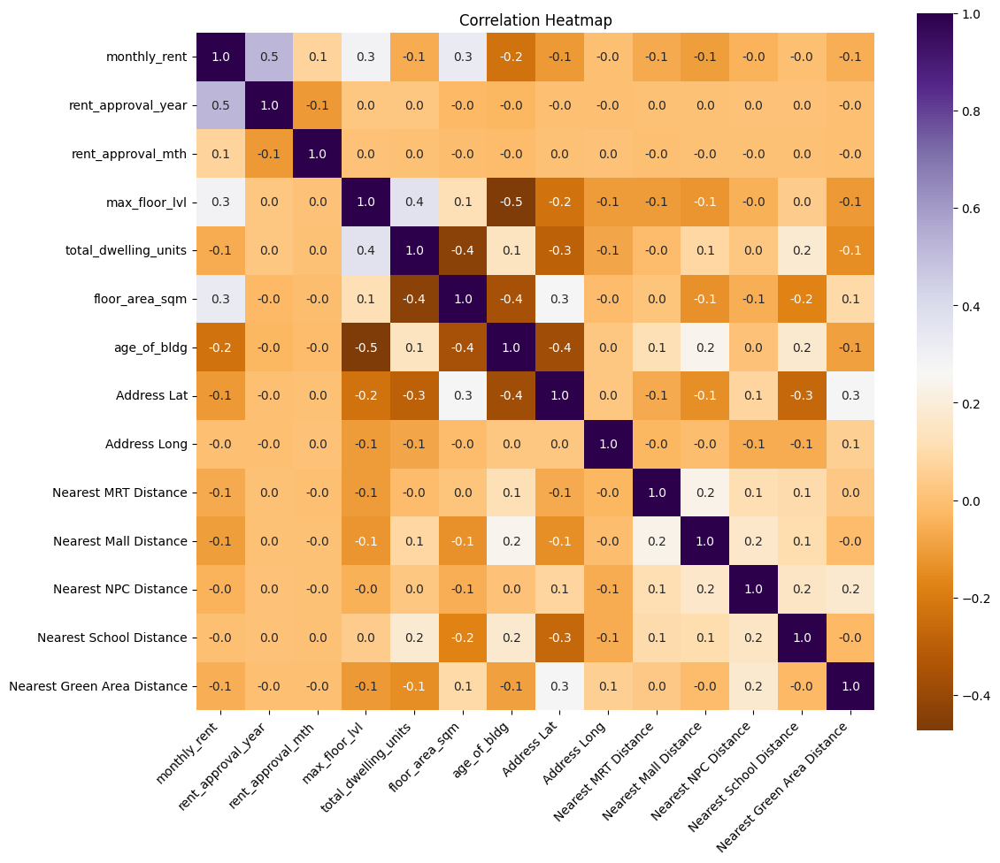

In [5]:
heatmap_data = data.select_dtypes(include=['number']).dropna(axis=1)
heatmap_data.drop(columns=['year_completed'], inplace=True)
corr = heatmap_data.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(
    corr,
    annot=True,        
    fmt='.1f',         
    cmap='PuOr',   
    cbar=True,         
    square=True        
)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.title('Correlation Heatmap')
plt.tight_layout()
plt.show()

Based on the heatmap, we can see that:<br>
There is a mild to moderate positive correlation between `monthly_rent` and `rent_approval_year`, `max_floor_lvl`, and `floor_area_sqm`

#### Analysis of `flat_type` and `monthly_rent`

In [6]:
flats = data['flat_type'].to_list()
flats_int = []
for flat in flats:
    if flat == "EXECUTIVE":
        flats_int.append(0)
    else:
        flats_int.append(int(flat[0]))
flats_int

[4,
 3,
 3,
 5,
 5,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 3,
 3,
 2,
 4,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 4,
 4,
 3,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 5,
 4,
 3,
 3,
 4,
 3,
 3,
 4,
 3,
 4,
 3,
 4,
 5,
 2,
 3,
 3,
 4,
 2,
 2,
 4,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 3,
 3,
 4,
 5,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 3,
 3,
 5,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 5,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 3,
 5,
 5,
 3,
 3,
 4,
 4,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 0,
 0,
 0,
 3,
 5,
 3,
 4,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 5,
 3,
 5,
 5,
 5,
 4,
 5,
 4,
 4,
 4,
 5,
 5,
 5,
 3,
 3,
 4,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 5,
 5,
 4,
 4,
 4,
 4,
 2,
 3,
 4,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 3,
 3,
 5,
 3,
 3,
 3,
 3,
 4,
 5,
 4,
 5,
 4,
 5,
 3,
 3,
 4,
 4,
 4,
 4,
 3,
 4,
 5,
 3,
 5,
 5,
 3,
 5,
 3,
 5,
 5,


In [7]:
data['flat_type_int'] = flats_int

Text(0.5, 1.0, 'Monthly Rent vs Flat Type')

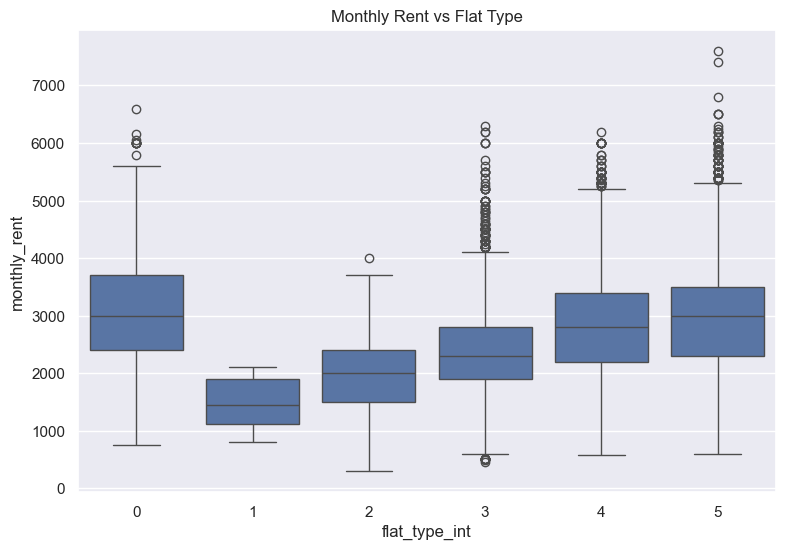

In [8]:
sns.set(rc={'figure.figsize':(9,6)})
sns.boxplot(x='flat_type_int', y='monthly_rent', data=data.sort_values(by='flat_type_int')) 
plt.title("Monthly Rent vs Flat Type")

As expected, there is a steady linear correlation between the monthly rent and the flat type. Flat type 0 refers to an executive-level HDB which are a step above regular HDB flats, hence the higher rent.

#### Analysis of `monthly_rent` over the years

Text(0.5, 1.0, 'Plot of monthly rent against the year of approval')

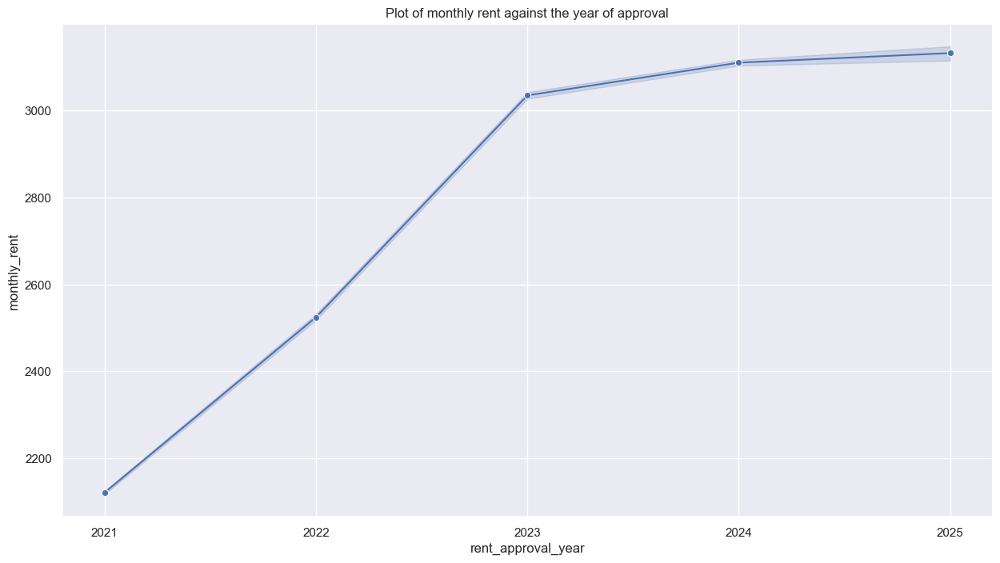

In [9]:
sns.set(rc={'figure.figsize':(15,8)})
sns.lineplot(x='rent_approval_year', y='monthly_rent', data=data, marker='o') 
# the wider the shaded area, the higher the uncertainty or variability in rent prices
plt.xticks(ticks=np.arange(start=data['rent_approval_year'].min(), stop=data['rent_approval_year'].max()+1, step=1))
plt.title("Plot of monthly rent against the year of approval")

Text(0.5, 1.0, 'Plot of rent prices against months from 2021-2025')

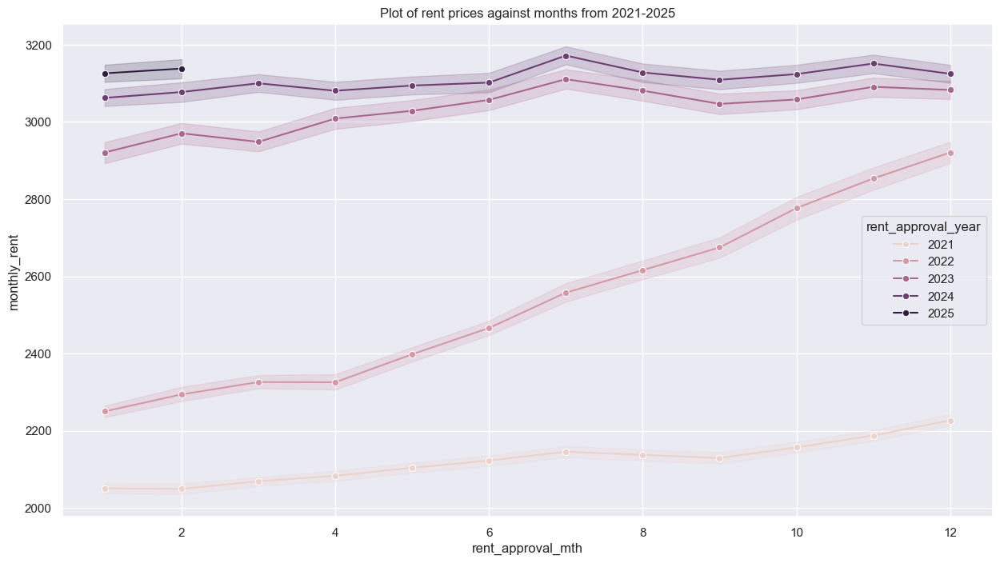

In [10]:
sns.lineplot(x='rent_approval_mth', y='monthly_rent', data=data, hue='rent_approval_year', marker='o') 
# the wider the shaded area, the higher the uncertainty or variability in rent prices
plt.title("Plot of rent prices against months from 2021-2025")

As expected, monthly rent prices exploded between 2021 and 2023, accounted for by the COVID-19 pandemic. In the subsequent few years, the market stabilised a little and the rent prices started to plateau.

#### Analysis of `monthly_rent` vs `floor_area_sqm`

Text(0.5, 1.0, 'Monthly rent price vs floor area (sqm)')

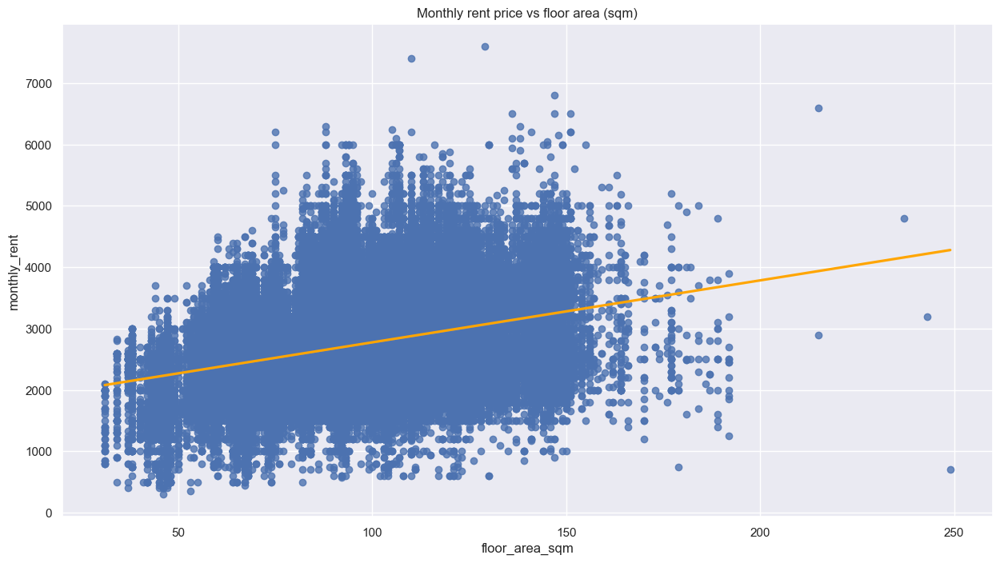

In [11]:
sns.regplot(x="floor_area_sqm",y="monthly_rent",data=data,line_kws={"color": "orange"})
plt.title("Monthly rent price vs floor area (sqm)")

The upward trend of the line shows a correlation between floor area and monthly rent. This is consistent with the correlation observed in the heatmap above.

#### Analysis of the effect of `flat_type`

In [12]:
data.groupby('flat_model')['monthly_rent'].median().sort_values()

flat_model
2-room                    2300.0
New Generation            2400.0
Standard                  2450.0
Simplified                2500.0
Model A2                  2500.0
Model A                   2700.0
Improved                  2700.0
Premium Apartment         2900.0
Maisonette                3000.0
Apartment                 3000.0
Model A-Maisonette        3150.0
DBSS                      3400.0
Adjoined flat             3400.0
Premium Maisonette        3500.0
Improved-Maisonette       3780.0
Premium Apartment Loft    4150.0
Terrace                   4300.0
Type S1                   4600.0
Type S2                   4950.0
Name: monthly_rent, dtype: float64

In [13]:
data['flat_model'].nunique()

19

There are 19 types of flats in the dataset listed for rent. One-hot encoding is inefficient and will constrain the memory space. Thus, it is imperative to convert this into a numerical value. We create an index based on the overall median rent price across the dataset and across each flat type and normalise that. This will result in: higher value, more premier flat type, and vice versa.

In [14]:
median_all = data['monthly_rent'].median()

flat_model_to_rent_dict = dict(data.groupby(by='flat_model')['monthly_rent'].median())
data['flat_model_index'] = data['flat_model'].apply(lambda model: flat_model_to_rent_dict[model] - median_all)
data['flat_model_index'] = (data['flat_model_index'] - data['flat_model_index'].min()) / (data['flat_model_index'].max() - data['flat_model_index'].min())
data.groupby("flat_model")['flat_model_index'].mean().sort_values(ascending=False)

flat_model
Type S2                   1.000000
Type S1                   0.867925
Terrace                   0.754717
Premium Apartment Loft    0.698113
Improved-Maisonette       0.558491
Premium Maisonette        0.452830
DBSS                      0.415094
Adjoined flat             0.415094
Model A-Maisonette        0.320755
Apartment                 0.264151
Maisonette                0.264151
Premium Apartment         0.226415
Improved                  0.150943
Model A                   0.150943
Model A2                  0.075472
Simplified                0.075472
Standard                  0.056604
New Generation            0.037736
2-room                    0.000000
Name: flat_model_index, dtype: float64

Text(0.5, 1.0, 'Monthly Rent vs Flat Models')

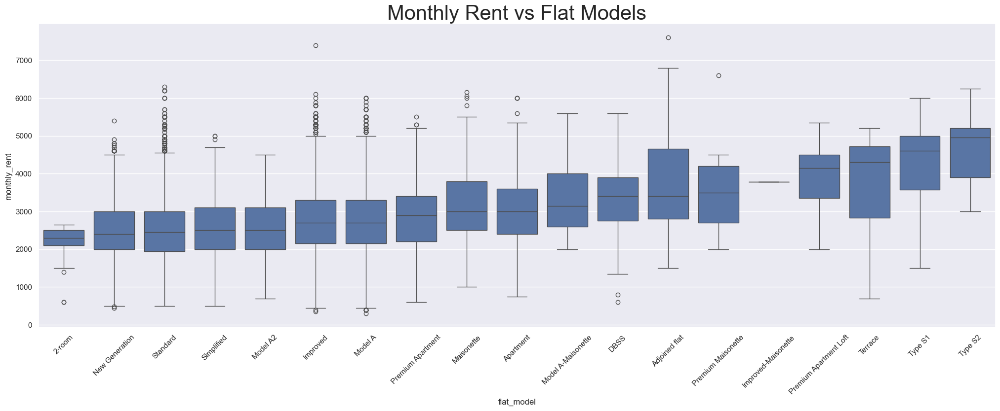

In [15]:
sns.set(rc={'figure.figsize':(25,8)})
sns.boxplot(x ='flat_model', y ='monthly_rent', data = data.sort_values(by="flat_model_index", ascending=True))
plt.xticks(rotation=45)
plt.title("Monthly Rent vs Flat Models", fontsize=30)

#### Analysis of the effect of `town`

In [16]:
data.groupby(by='town')['monthly_rent'].median().sort_values(ascending=False)

town
BUKIT TIMAH        3000.0
CENTRAL            3000.0
BISHAN             2900.0
BUKIT MERAH        2900.0
QUEENSTOWN         2850.0
PUNGGOL            2800.0
SENGKANG           2800.0
PASIR RIS          2750.0
CLEMENTI           2750.0
JURONG WEST        2700.0
KALLANG/WHAMPOA    2700.0
TAMPINES           2700.0
SERANGOON          2700.0
MARINE PARADE      2600.0
SEMBAWANG          2600.0
JURONG EAST        2600.0
CHOA CHU KANG      2600.0
BUKIT PANJANG      2600.0
TOA PAYOH          2550.0
WOODLANDS          2500.0
ANG MO KIO         2500.0
BEDOK              2500.0
HOUGANG            2500.0
GEYLANG            2500.0
BUKIT BATOK        2500.0
YISHUN             2450.0
Name: monthly_rent, dtype: float64

In [17]:
data['town'].nunique()

26

There are 26 towns in the dataset with apartments for rent. One-hot encoding is inefficient and will constrain the memory space. Thus, it is imperative to convert this into a numerical value. We create an index based on the overall median rent price across the dataset and across each town and normalise that. This will result in: higher value, more premier town, and vice versa.

In [18]:
median_all = data['monthly_rent'].median()

town_to_monthly_rent_dict = dict(data.groupby(by='town')['monthly_rent'].median())
data['town_index'] = data['town'].apply(lambda town: town_to_monthly_rent_dict[town] - median_all)
data['town_index'] = (data['town_index'] - data['town_index'].min()) / (data['town_index'].max() - data['town_index'].min())
data.groupby("town")['town_index'].mean().sort_values(ascending=False)

town
BUKIT TIMAH        1.000000
CENTRAL            1.000000
BISHAN             0.818182
BUKIT MERAH        0.818182
QUEENSTOWN         0.727273
PUNGGOL            0.636364
SENGKANG           0.636364
PASIR RIS          0.545455
CLEMENTI           0.545455
KALLANG/WHAMPOA    0.454545
JURONG WEST        0.454545
TAMPINES           0.454545
SERANGOON          0.454545
MARINE PARADE      0.272727
SEMBAWANG          0.272727
JURONG EAST        0.272727
CHOA CHU KANG      0.272727
BUKIT PANJANG      0.272727
TOA PAYOH          0.181818
WOODLANDS          0.090909
ANG MO KIO         0.090909
BEDOK              0.090909
HOUGANG            0.090909
GEYLANG            0.090909
BUKIT BATOK        0.090909
YISHUN             0.000000
Name: town_index, dtype: float64

Text(0.5, 1.0, 'Monthly Rent vs Town')

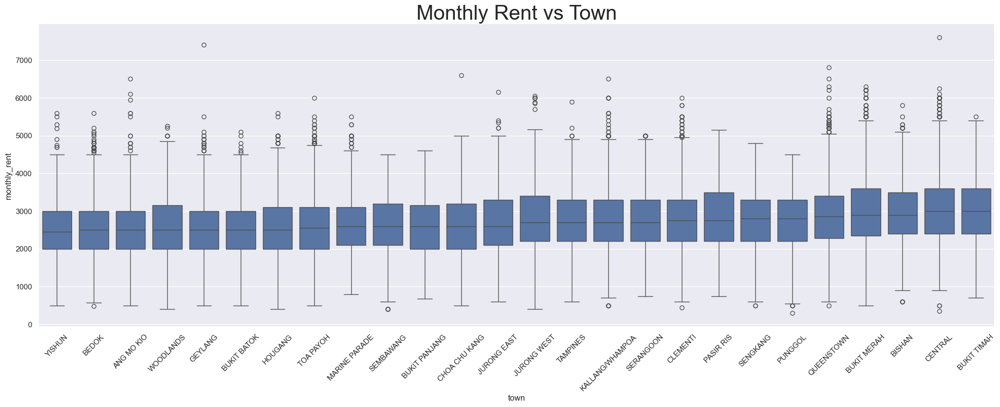

In [19]:
sns.set(rc={'figure.figsize':(25,8)})
sns.boxplot(x ='town', y ='monthly_rent', data = data.sort_values(by="town_index", ascending=True))
plt.xticks(rotation=45)
plt.title("Monthly Rent vs Town", fontsize=30)

Based on the `town_index`, Bukit Timah, Central, and Bishan have the most expensive flats for rent whereas Geylang, Bukit Batok, and Yishun have the lowest rents. This is consistent with observable data in real life in Singapore.

#### Analysis of Location

In [20]:
fig = px.scatter_mapbox(data, lat="Address Lat", lon="Address Long",
                            color="monthly_rent",
                            size_max=20,
                            zoom=10,
                            height=500,
                            hover_data={'Address Lat': False,
                                        'Address Long': False,
                                        'town': True,
                                        'monthly_rent': True
                                        },
                            color_continuous_scale='Spectral'
                            )
fig.update_layout(mapbox_style="open-street-map")
fig.show()

/var/folders/8f/56qvs3bd6jsbf5sy0qgrzr680000gn/T/ipykernel_8098/2494777401.py:1: DeprecationWarning: *scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.scatter_mapbox(data, lat="Address Lat", lon="Address Long",


Interactive map to check rent prices across different locations.

#### Analysis of Nearest MRT Station

In [21]:
data['Nearest MRT Station'].nunique()

144

There are 144 MRT stations in the dataset that the apartments for rent are close to. One-hot encoding is inefficient and will constrain the memory space. Thus, it is imperative to convert this into a numerical value. We create an index based on the overall median rent price across the dataset and across MRT stations and normalise that. This will result in: higher value, more premier MRT station, and vice versa.

In [22]:
median_all = data['monthly_rent'].median()

dict_mrt_to_monthly_rent = dict(data.groupby(by='Nearest MRT Station')['monthly_rent'].median())
data['mrt_index'] = data['Nearest MRT Station'].apply(lambda model: dict_mrt_to_monthly_rent[model] - median_all)
data['mrt_index'] = (data['mrt_index'] - data['mrt_index'].min()) / (data['mrt_index'].max() - data['mrt_index'].min())
data.groupby("Nearest MRT Station")['mrt_index'].mean().sort_values(ascending=False)

Nearest MRT Station
GREAT WORLD MRT STATION (TE15)        1.000000
LABRADOR PARK MRT STATION (CC27)      1.000000
BENDEMEER MRT STATION (DT23)          0.941176
CALDECOTT MRT STATION (TE9)           0.882353
OUTRAM PARK MRT STATION (NE3)         0.882353
                                        ...   
MATTAR MRT STATION (DT25)             0.176471
PENDING LRT STATION (BP8)             0.176471
TECK WHYE LRT STATION (BP4)           0.117647
KING ALBERT PARK MRT STATION (DT6)    0.058824
TAI SENG MRT STATION (CC11)           0.000000
Name: mrt_index, Length: 144, dtype: float64

Text(0.5, 1.0, 'Rent vs Nearest MRT')

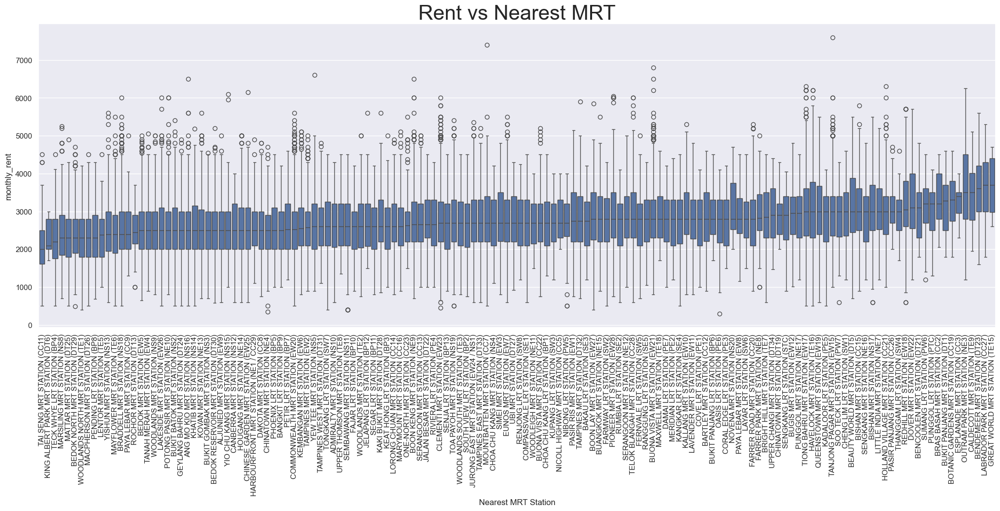

In [23]:
sns.set(rc={'figure.figsize':(25,8)})
sns.boxplot(x ='Nearest MRT Station', y ='monthly_rent', data = data.sort_values(by="mrt_index", ascending=True))
plt.xticks(rotation=90)
plt.title("Rent vs Nearest MRT", fontsize=30)

Based on the `mrt_index`, stations such as Great World, Labrador Park, Bendemeer, and Outram Park are considered more premier due to higher population of affluent persons, location, and/or connectivity.

Text(0.5, 1.0, 'Monthly Rent vs Nearest MRT station (by km)')

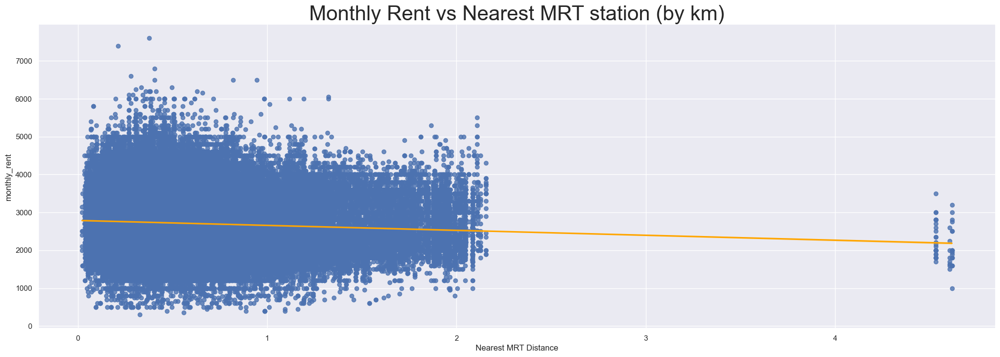

In [24]:
sns.regplot(x="Nearest MRT Distance",y="monthly_rent",data=data,line_kws={"color": "orange"})
plt.title("Monthly Rent vs Nearest MRT station (by km)", fontsize=30)

This shows that rent prices rise as flats are located closer to MRT stations, a finding that aligns with the well‑established market insight that proximity to transit hubs commands a premium due to the added convenience.

#### Analysis of Nearest Mall

In [25]:
data['Nearest Mall Name'].nunique()

109

There are 109 malls in the dataset that the apartments for rent are close to. One-hot encoding is inefficient and will constrain the memory space. Thus, it is imperative to convert this into a numerical value. We create an index based on the overall median rent price across the dataset and across malls and normalise that. This will result in: higher value, more premier mall, and vice versa.

In [26]:
median_all = data['monthly_rent'].median()
mall_to_rent_dict = dict(data.groupby(by='Nearest Mall Name')['monthly_rent'].median())
data['mall_index'] = data['Nearest Mall Name'].apply(lambda model: mall_to_rent_dict[model] - median_all)
data['mall_index'] = (data['mall_index'] - data['mall_index'].min()) / (data['mall_index'].max() - data['mall_index'].min())
data.groupby("Nearest Mall Name")['mall_index'].mean().sort_values(ascending=False)

Nearest Mall Name
100 AM                               1.000000
PLQ MALL                             1.000000
DAWSON PLACE                         1.000000
JW MARRIOTT SINGAPORE SOUTH BEACH    0.928571
RAFFLES CITY SHOPPING CENTRE         0.857143
                                       ...   
SEMBAWANG SHOPPING CENTRE            0.285714
HOUGANG RIVERCOURT                   0.214286
PAYA LEBAR SQUARE                    0.214286
THE MAJESTIC                         0.142857
JEWEL CHANGI AIRPORT                 0.000000
Name: mall_index, Length: 109, dtype: float64

Text(0.5, 1.0, 'Rent vs Nearest Mall')

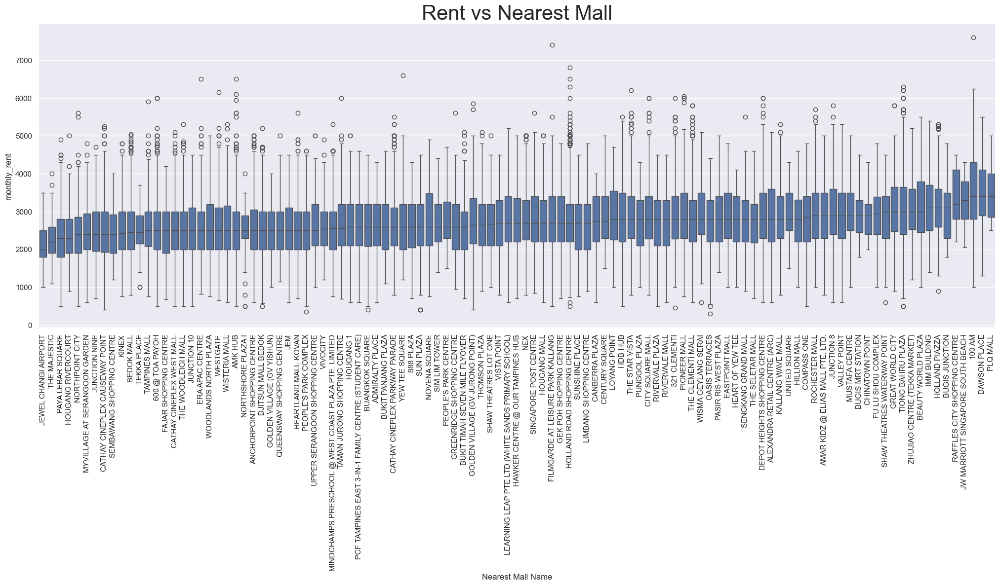

In [27]:
sns.set(rc={'figure.figsize':(25,8)})
sns.boxplot(x ='Nearest Mall Name', y ='monthly_rent', data = data.sort_values(by="mall_index", ascending=True))
plt.xticks(rotation=90)
plt.title("Rent vs Nearest Mall", fontsize=30)

Text(0.5, 1.0, 'Rent vs Nearest Mall')

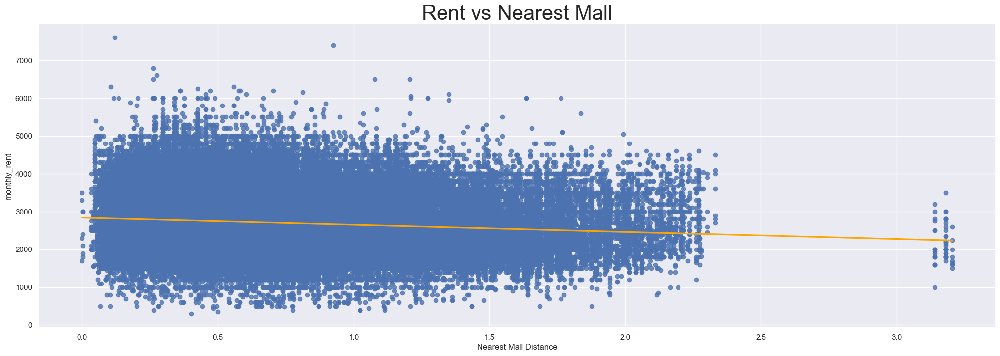

In [31]:
sns.regplot(x="Nearest Mall Distance",y="monthly_rent",data=data,line_kws={"color": "orange"})
plt.title("Rent vs Nearest Mall", fontsize=30)

#### Analysis of Nearest NPC

In [33]:
data['Nearest NPC'].nunique()

31

Text(0.5, 1.0, 'Rent vs Nearest NPC')

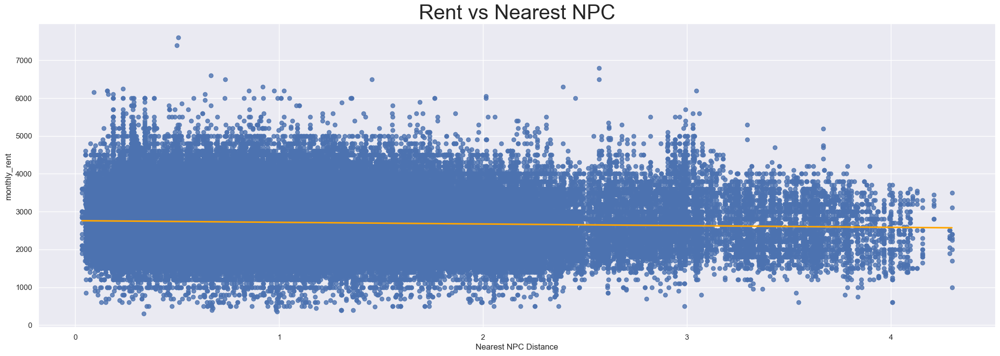

In [34]:
sns.regplot(x="Nearest NPC Distance",y="monthly_rent",data=data,line_kws={"color": "orange"})
plt.title("Rent vs Nearest NPC", fontsize=30)

There is no discernable trend as Singapore is generally a safe place.

#### Analysis of Nearest School

Text(0.5, 1.0, 'Rent vs Nearest School')

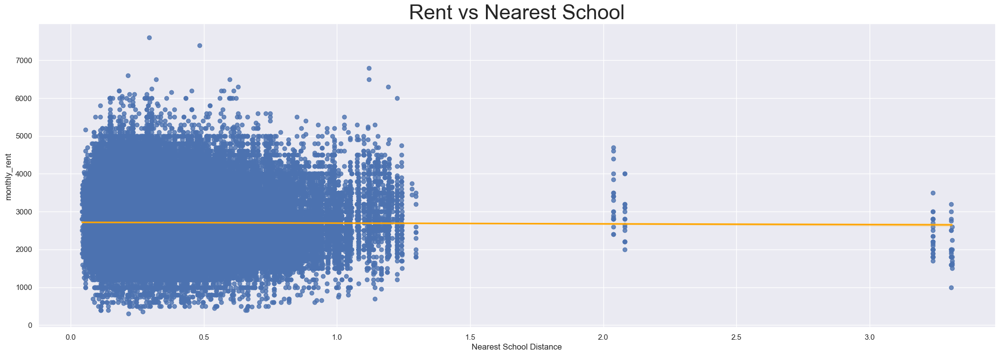

In [38]:
sns.regplot(x="Nearest School Distance",y="monthly_rent",data=data,line_kws={"color": "orange"})
plt.title("Rent vs Nearest School", fontsize=30)

There is no discernable trend as there are many factors besides distance that affects the decision of which school children are sent to, or which school is more "elite".

#### Analysis of Nearest Green Area

Text(0.5, 1.0, 'Rent vs Nearest Green Area')

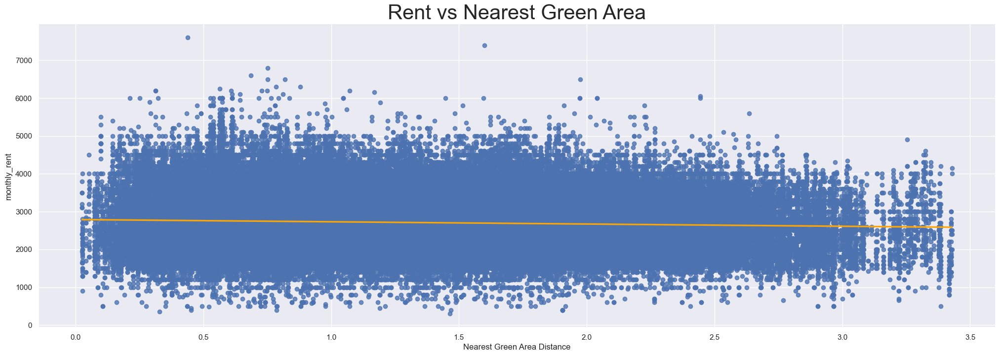

In [41]:
sns.regplot(x="Nearest Green Area Distance",y="monthly_rent",data=data,line_kws={"color": "orange"})
plt.title("Rent vs Nearest Green Area", fontsize=30)

There is no discernable trend between Nearest Green Area and monthly rent prices.

#### Converting YN columns to binary

In [43]:
yn_cols = [
    col for col in data.columns 
    if set(data[col].dropna().unique()) <= {'Y','N'}
]

data[yn_cols] = data[yn_cols].apply(lambda col: col.map({'Y': 1, 'N': 0}))
print(data[yn_cols].head())

   residential  commercial  market_hawker  miscellaneous  multistorey_carpark  \
0            1           0              0              0                    0   
1            1           1              0              0                    0   
2            1           1              0              0                    0   
3            1           0              0              1                    0   
4            1           0              0              1                    0   

   precinct_pavilion  
0                  0  
1                  0  
2                  0  
3                  0  
4                  0  


### Final Processing

In [48]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150696 entries, 0 to 150695
Data columns (total 39 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   rent_approval_date           150696 non-null  object 
 1   town                         150696 non-null  object 
 2   block                        150696 non-null  object 
 3   street_name                  150696 non-null  object 
 4   flat_type                    150696 non-null  object 
 5   monthly_rent                 150696 non-null  int64  
 6   rent_approval_year           150696 non-null  int64  
 7   rent_approval_mth            150696 non-null  int64  
 8   max_floor_lvl                150696 non-null  float64
 9   year_completed               150696 non-null  int64  
 10  residential                  150696 non-null  int64  
 11  commercial                   150696 non-null  int64  
 12  market_hawker                150696 non-null  int64  
 13 

Removing columns that are not going to be used for training

In [68]:
get_rid_of_cols = ['rent_approval_date', 'town', 'block', 'street_name', 'flat_type', 'year_completed', 'bldg_contract_town', 
                   'total_dwelling_units', 'flat_model', 'address', 'Address Lat', 'Address Long', 'Nearest MRT Station', 
                   'Nearest Mall Name', 'Nearest NPC', 'Nearest School', 'Nearest Green Area']

data_v2 = data.drop(columns=get_rid_of_cols)
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150696 entries, 0 to 150695
Data columns (total 22 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   monthly_rent                 150696 non-null  int64  
 1   rent_approval_year           150696 non-null  int64  
 2   rent_approval_mth            150696 non-null  int64  
 3   max_floor_lvl                150696 non-null  float64
 4   residential                  150696 non-null  int64  
 5   commercial                   150696 non-null  int64  
 6   market_hawker                150696 non-null  int64  
 7   miscellaneous                150696 non-null  int64  
 8   multistorey_carpark          150696 non-null  int64  
 9   precinct_pavilion            150696 non-null  int64  
 10  floor_area_sqm               150696 non-null  float64
 11  age_of_bldg                  150696 non-null  int64  
 12  Nearest MRT Distance         150696 non-null  float64
 13 

One-hot encoding of month and year

In [69]:
data_v2 = pd.get_dummies(
    data_v2,
    columns=['rent_approval_year'],
    prefix='year',
    prefix_sep='_',
    dtype=int
)
data_v2

,monthly_rent,rent_approval_mth,max_floor_lvl,residential,commercial,market_hawker,miscellaneous,multistorey_carpark,precinct_pavilion,floor_area_sqm,...,flat_type_int,flat_model_index,town_index,mrt_index,mall_index,year_2021,year_2022,year_2023,year_2024,year_2025
0,2000,1,10.0,1,0,0,0,0,0,92.0,...,4,0.037736,0.090909,0.235294,0.357143,1,0,0,0,0
1,1750,1,11.0,1,1,0,0,0,0,74.0,...,3,0.037736,0.090909,0.235294,0.357143,1,0,0,0,0
2,1750,1,12.0,1,1,0,0,0,0,67.0,...,3,0.037736,0.090909,0.235294,0.357143,1,0,0,0,0
3,2230,1,12.0,1,0,0,1,0,0,117.0,...,5,0.150943,0.090909,0.235294,0.357143,1,0,0,0,0
4,2450,1,12.0,1,0,0,1,0,0,117.0,...,5,0.150943,0.090909,0.235294,0.357143,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150691,3000,2,16.0,1,0,0,0,0,0,110.0,...,5,0.150943,0.636364,0.470588,0.571429,0,0,0,0,1
150692,4000,2,40.0,1,0,0,0,0,0,93.0,...,4,0.150943,0.181818,0.882353,0.571429,0,0,0,0,1
150693,5000,2,12.0,1,0,0,1,0,0,84.0,...,4,0.075472,0.818182,0.617647,1.000000,0,0,0,0,1
150694,3200,2,19.0,1,0,0,1,0,0,93.0,...,4,0.150943,0.272727,0.352941,0.500000,0,0,0,0,1


In [70]:
data_v2 = pd.get_dummies(
    data_v2,
    columns=['rent_approval_mth'],
    prefix='month',
    prefix_sep='_',
    dtype=int
)
data_v2

,monthly_rent,max_floor_lvl,residential,commercial,market_hawker,miscellaneous,multistorey_carpark,precinct_pavilion,floor_area_sqm,age_of_bldg,...,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,2000,10.0,1,0,0,0,0,0,92.0,48,...,0,0,0,0,0,0,0,0,0,0
1,1750,11.0,1,1,0,0,0,0,74.0,48,...,0,0,0,0,0,0,0,0,0,0
2,1750,12.0,1,1,0,0,0,0,67.0,47,...,0,0,0,0,0,0,0,0,0,0
3,2230,12.0,1,0,0,1,0,0,117.0,48,...,0,0,0,0,0,0,0,0,0,0
4,2450,12.0,1,0,0,1,0,0,117.0,48,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150691,3000,16.0,1,0,0,0,0,0,110.0,24,...,0,0,0,0,0,0,0,0,0,0
150692,4000,40.0,1,0,0,0,0,0,93.0,8,...,0,0,0,0,0,0,0,0,0,0
150693,5000,12.0,1,0,0,1,0,0,84.0,39,...,0,0,0,0,0,0,0,0,0,0
150694,3200,19.0,1,0,0,1,0,0,93.0,9,...,0,0,0,0,0,0,0,0,0,0


In [74]:
data_v2.columns.to_list

<bound method IndexOpsMixin.tolist of Index(['monthly_rent', 'max_floor_lvl', 'residential', 'commercial',
       'market_hawker', 'miscellaneous', 'multistorey_carpark',
       'precinct_pavilion', 'floor_area_sqm', 'age_of_bldg',
       'Nearest MRT Distance', 'Nearest Mall Distance', 'Nearest NPC Distance',
       'Nearest School Distance', 'Nearest Green Area Distance',
       'flat_type_int', 'flat_model_index', 'town_index', 'mrt_index',
       'mall_index', 'year_2021', 'year_2022', 'year_2023', 'year_2024',
       'year_2025', 'month_1', 'month_2', 'month_3', 'month_4', 'month_5',
       'month_6', 'month_7', 'month_8', 'month_9', 'month_10', 'month_11',
       'month_12'],
      dtype='object')>

### Conclusion

#### Final Heatmap between Features

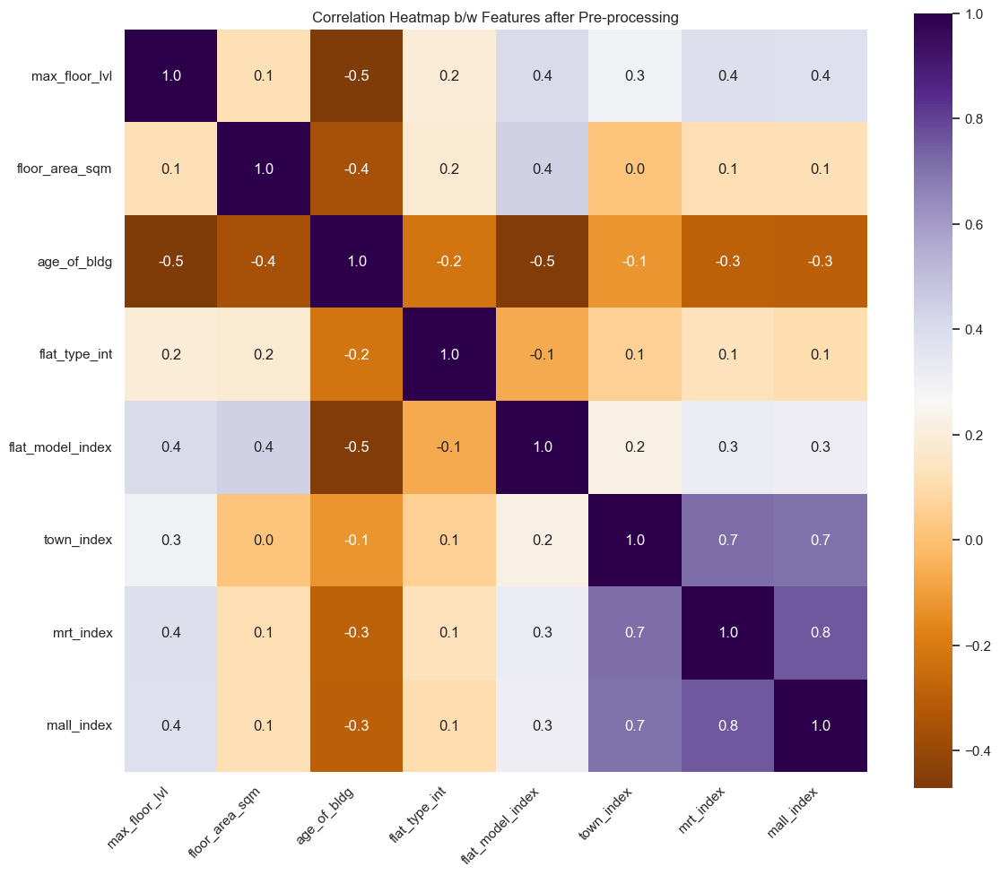

In [77]:
heatmap_data_v2 = data_v2.select_dtypes(include=['number']).dropna(axis=1)
heatmap_data_v2.drop(columns=['monthly_rent', 'residential', 'commercial', 'market_hawker', 'miscellaneous', 'multistorey_carpark', 
                              'precinct_pavilion', 'Nearest MRT Distance', 'Nearest Mall Distance',
                              'Nearest NPC Distance', 'Nearest School Distance', 'Nearest Green Area Distance',
                              'year_2021', 'year_2022', 'year_2023', 'year_2024',
                              'year_2025', 'month_1', 'month_2', 'month_3', 'month_4', 'month_5',
                              'month_6', 'month_7', 'month_8', 'month_9', 'month_10', 'month_11',
                              'month_12'], inplace=True)
corr = heatmap_data_v2.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(
    corr,
    annot=True,        
    fmt='.1f',         
    cmap='PuOr',   
    cbar=True,         
    square=True        
)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.title('Correlation Heatmap b/w Features after Pre-processing')
plt.tight_layout()
plt.show()

#### Principal Component Analysis

Text(0, 0.5, 'Principal Component 2 (PC2)')

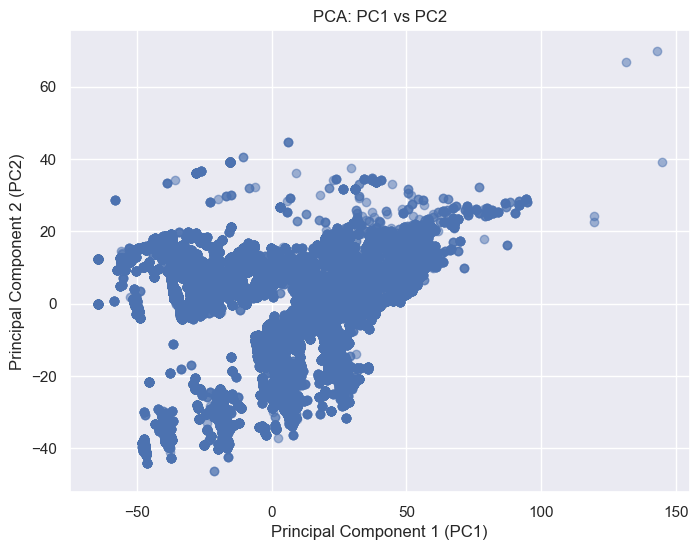

In [79]:
scaler = StandardScaler()
X_std = data_v2.drop("monthly_rent", axis=1)

pca = PCA(n_components=2)
principalComponents = pca.fit_transform(X_std)
pca_df = pd.DataFrame(data=principalComponents, columns=['PC1', 'PC2'])

plt.figure(figsize=(8, 6))
plt.scatter(pca_df['PC1'], pca_df['PC2'], alpha=0.5)
plt.title('PCA: PC1 vs PC2')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')

Ultimately, not all seemingly unrelated features are removed from the dataset aas further machine learning exploration may identofy relationships as yet uncovered.

In [81]:
# data_v2.to_csv("csvs/df_final.csv", index=False)

--- END ---